# TAREA 3. Animación Perceptron 

## Equipo 11. 
 - Iñaki Fernandez Fiscal 
 - Guillermo Arredondo Renero
 - Mauricio Vazquez Moran


In [24]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation


from sklearn.datasets import load_iris
from sklearn.model_selection import train_test_split
from matplotlib import rc

In [25]:
iris = load_iris()
X = iris.data
Y = iris.target

In [26]:
dir(iris)

['DESCR',
 'data',
 'data_module',
 'feature_names',
 'filename',
 'frame',
 'target',
 'target_names']

In [27]:
iris.feature_names

['sepal length (cm)',
 'sepal width (cm)',
 'petal length (cm)',
 'petal width (cm)']

In [28]:
iris.target_names

array(['setosa', 'versicolor', 'virginica'], dtype='<U10')

In [29]:
iris.data

array([[5.1, 3.5, 1.4, 0.2],
       [4.9, 3. , 1.4, 0.2],
       [4.7, 3.2, 1.3, 0.2],
       [4.6, 3.1, 1.5, 0.2],
       [5. , 3.6, 1.4, 0.2],
       [5.4, 3.9, 1.7, 0.4],
       [4.6, 3.4, 1.4, 0.3],
       [5. , 3.4, 1.5, 0.2],
       [4.4, 2.9, 1.4, 0.2],
       [4.9, 3.1, 1.5, 0.1],
       [5.4, 3.7, 1.5, 0.2],
       [4.8, 3.4, 1.6, 0.2],
       [4.8, 3. , 1.4, 0.1],
       [4.3, 3. , 1.1, 0.1],
       [5.8, 4. , 1.2, 0.2],
       [5.7, 4.4, 1.5, 0.4],
       [5.4, 3.9, 1.3, 0.4],
       [5.1, 3.5, 1.4, 0.3],
       [5.7, 3.8, 1.7, 0.3],
       [5.1, 3.8, 1.5, 0.3],
       [5.4, 3.4, 1.7, 0.2],
       [5.1, 3.7, 1.5, 0.4],
       [4.6, 3.6, 1. , 0.2],
       [5.1, 3.3, 1.7, 0.5],
       [4.8, 3.4, 1.9, 0.2],
       [5. , 3. , 1.6, 0.2],
       [5. , 3.4, 1.6, 0.4],
       [5.2, 3.5, 1.5, 0.2],
       [5.2, 3.4, 1.4, 0.2],
       [4.7, 3.2, 1.6, 0.2],
       [4.8, 3.1, 1.6, 0.2],
       [5.4, 3.4, 1.5, 0.4],
       [5.2, 4.1, 1.5, 0.1],
       [5.5, 4.2, 1.4, 0.2],
       [4.9, 3

In [30]:
Y

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2])

In [31]:
X = X[:,0:2]
X

array([[5.1, 3.5],
       [4.9, 3. ],
       [4.7, 3.2],
       [4.6, 3.1],
       [5. , 3.6],
       [5.4, 3.9],
       [4.6, 3.4],
       [5. , 3.4],
       [4.4, 2.9],
       [4.9, 3.1],
       [5.4, 3.7],
       [4.8, 3.4],
       [4.8, 3. ],
       [4.3, 3. ],
       [5.8, 4. ],
       [5.7, 4.4],
       [5.4, 3.9],
       [5.1, 3.5],
       [5.7, 3.8],
       [5.1, 3.8],
       [5.4, 3.4],
       [5.1, 3.7],
       [4.6, 3.6],
       [5.1, 3.3],
       [4.8, 3.4],
       [5. , 3. ],
       [5. , 3.4],
       [5.2, 3.5],
       [5.2, 3.4],
       [4.7, 3.2],
       [4.8, 3.1],
       [5.4, 3.4],
       [5.2, 4.1],
       [5.5, 4.2],
       [4.9, 3.1],
       [5. , 3.2],
       [5.5, 3.5],
       [4.9, 3.6],
       [4.4, 3. ],
       [5.1, 3.4],
       [5. , 3.5],
       [4.5, 2.3],
       [4.4, 3.2],
       [5. , 3.5],
       [5.1, 3.8],
       [4.8, 3. ],
       [5.1, 3.8],
       [4.6, 3.2],
       [5.3, 3.7],
       [5. , 3.3],
       [7. , 3.2],
       [6.4, 3.2],
       [6.9,

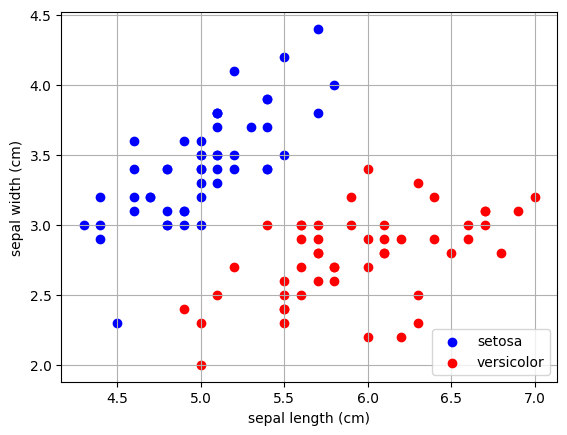

In [32]:
fig, ax = plt.subplots()

line, = ax.plot([], [], 'k-')

ax.scatter(X[Y==0, 0], X[Y==0, 1], c='b', label=iris.target_names[0])
ax.scatter(X[Y==1, 0], X[Y==1, 1], c='r', label=iris.target_names[1])
ax.legend(loc='lower right')

ax.set_xlabel(iris.feature_names[0])
#ax.set_xlim(0, 6)
ax.set_ylabel(iris.feature_names[1])
#ax.set_ylim(0, 2)

x = np.linspace(ax.get_xlim()[0], ax.get_xlim()[1], 200)

ax.grid(True)

In [ ]:
# theta   = np.zeros(2)
# theta_0 = 0

# lista_thetas=[]

# # lista_thetas.append((-theta_0/theta[1],-theta[0]/theta[1]))

# lista_thetas.append( (-5.0, -6.999999999999999) )
# lista_thetas.append( (0.0, -2.7500000000000004) )
# lista_thetas.append( (1.0, -1.9000000000000004) )
# lista_thetas.append( (2.5, -0.6250000000000006) )
# lista_thetas.append( (-0.2857142857142857, -1.457142857142857) )
# lista_thetas.append( (-0.0, 6.333333333333338) )
# lista_thetas.append( (-0.31026252983293573, 0.5513126491646785) )
# lista_thetas.append( (-0.3108808290155442, 0.7616580310880837) )
# lista_thetas.append( (-0.4173622704507524, 0.5976627712854786) )
# lista_thetas.append( (-0.4195804195804208, 0.7167832167832201) )
# lista_thetas.append( (-0.467032967032969, 0.6085164835164876) )
# lista_thetas.append( (-0.47075606276747706, 0.7061340941512172) )
# lista_thetas.append( (-0.4904306220095721, 0.5873205741626849) )
# lista_thetas.append( (-0.4981320049813229, 0.6899128268991345) )
# lista_thetas.append( (-0.6293706293706338, 0.6480186480186545) )
# lista_thetas.append( (-0.6400966183574925, 0.7391304347826161) )
# lista_thetas.append( (-0.7415730337078712, 0.6786516853932658) )
# lista_thetas.append( (-0.7338444687842337, 0.6122672508214744) )
# lista_thetas.append( (-0.7491486946651594, 0.7071509648127206) )
# lista_thetas.append( (-0.8287895310796148, 0.6837513631406854) )
# lista_thetas.append( (-0.8455467869222175, 0.7677564825253768) )
# lista_thetas.append( (-0.9378407851690393, 0.6837513631406876) )
# lista_thetas.append( (-0.9550561797752912, 0.7629213483146196) )
# lista_thetas.append( (-1.0398230088495701, 0.741150442477891) )
# lista_thetas.append( (-1.0640732265446358, 0.8283752860412065) )
# lista_thetas.append( (-1.0907127429805754, 0.7494600431965609) )
# lista_thetas.append( (-1.1160714285714433, 0.8348214285714469) )
# lista_thetas.append( (-1.1440677966101847, 0.7648305084745948) )
# lista_thetas.append( (-1.1706783369803222, 0.8490153172866725) )
# lista_thetas.append( (-1.1491935483871134, 0.7207661290322787) )
# lista_thetas.append( (-1.1673553719008438, 0.7892561983471297) )
# lista_thetas.append( (-1.170108161258623, 0.7286135693215583) )
# lista_thetas.append( (-1.191919191919212, 0.8010101010101274) )
# lista_thetas.append( (-1.2168792934249493, 0.7693817468106278) )
# lista_thetas.append( (-1.24368048533875, 0.8473205257836514) )
# lista_thetas.append( (-1.2426035502958825, 0.7869822485207414) )

In [34]:
def perceptron(T, X, Y): 
    thetas = []
    theta = np.zeros(X.shape[1])
    theta_0 = 0
    for i in range(T):
        for xi, yi in zip(X,Y):
            if yi*(np.dot(xi, theta)+theta_0) <= 0:
                theta = theta + np.dot(yi,xi)
                theta_0 = theta_0 + yi
            thetas.append((-theta_0/theta[1],-theta[0]/theta[1]))
#            thetas.append((theta, theta_0))
    return thetas

In [35]:
Y_mod = np.array(list(map(lambda x: 1 if x==0 else -1, Y)))
Y_mod

array([ 1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1, -1,
       -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
       -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
       -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
       -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
       -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1,
       -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1])

In [36]:
X_train, X_test, y_train, y_test = train_test_split(
    X, Y_mod, test_size=0.2, random_state=42)

In [45]:
lista_thetas = perceptron(10, X_train, y_train)

In [38]:
lista_thetas

[(-0.2777777777777778, -1.2777777777777777),
 (-0.2777777777777778, -1.2777777777777777),
 (0.0, 4.200000000000001),
 (-0.25641025641025644, -0.6923076923076922),
 (-0.25641025641025644, -0.6923076923076922),
 (0.0, 2.571428571428572),
 (0.0, 2.571428571428572),
 (-0.2040816326530612, -0.3265306122448979),
 (-0.2040816326530612, -0.3265306122448979),
 (-0.2040816326530612, -0.3265306122448979),
 (0.0, 1.909090909090909),
 (0.0, 1.909090909090909),
 (0.0, 1.909090909090909),
 (-0.1639344262295082, -0.1967213114754099),
 (-0.1639344262295082, -0.1967213114754099),
 (0.0, 1.1621621621621623),
 (0.0, 1.1621621621621623),
 (0.0, 1.1621621621621623),
 (0.0, 1.1621621621621623),
 (0.0, 1.1621621621621623),
 (0.0, 1.1621621621621623),
 (0.0, 1.1621621621621623),
 (0.0, 1.1621621621621623),
 (-0.1388888888888889, -0.11111111111111109),
 (0.0, 1.5681818181818183),
 (0.0, 1.5681818181818183),
 (-0.12820512820512822, 0.217948717948718),
 (-0.12820512820512822, 0.217948717948718),
 (-0.128205128205

In [39]:
def anima(i):
    y = lista_thetas[i][0] + lista_thetas[i][1] * x
    line.set_data(x, y)
    return line,

In [46]:
animacion = animation.FuncAnimation(fig, anima, frames=len(lista_thetas), interval=100, blit=True)
rc('animation', html='jshtml')
animacion

Animation size has reached 21008355 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
